# Model Selection Part 2/3 - Models & Frameworks Exploration

### Short description

Models architectures and parameters exploration

    - Dataset : 165K products, 938 features, 2 labels to predict (G1 with 9 labels, G2 with 38 labels)
    - Note that classes are highly imbalanced (especially for G2). 
    - We stratify the train/test split on G2 and use balanced class weights parameters when possible.
    - Models tried : 
        - Tree based models (Decision Tree, Random Forest, Adaboost)
        - Linear Models : Logistic Regression with  Standard Scaling and PCA
        - Other models : SVM with RBF Kernel (on principal components)
    - Frameworks : Ensembles, One-vs-rest and Chain Classifiers (Predict G1, append prediction to X, predict G2)

**Result & One line Conclusion:** 

* ** Tree based models in Chain seems to be the most adapted framework. Saved model for further exploration : Adaboost**

## Notebook Configuration

### Imports

In [4]:
#Standard
import pandas as pd
import numpy as np 
import time 
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.lib.deepreload import reload as dreload

#Preprocess
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.decomposition import PCA

#Models
from sklearn.ensemble import RandomForestClassifier
from sklearn.multioutput import ClassifierChain
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

#Evaluation
from sklearn import metrics

#custom eval functions
from eml.model_eval import classifier_metrics, get_classification_report, plot_confusion_matrix


#Settings
%load_ext autoreload
%autoreload 2
%matplotlib inline
pd.set_option("display.max_columns", 200, "display.max_rows", 200)

# Part 1 - Predict $G_1$ - Ensembles & Linear Models
### $Card(G_1) = {9 labels}$

## Data

### Load dataset

In [3]:
df_modified = pd.read_csv(r'C:\Users\Antoine\Coding Bootcamp\Open Food Facts\data_training_names.csv', low_memory=False)

In [7]:
df_copy = df_modified.copy(deep=True)

### Train_test_split & sample datasets

In [4]:
features = df_modified.drop(columns=['pnns_groups_1', 'pnns_groups_2', 'pnns_groups_3', 'pnns_groups_4', 'code', 'url', 'ingredients', 'product_name'])
target = df_modified['pnns_groups_1']
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42, stratify=target)
X_train_sample = X_train.sample(40000, random_state=1)
y_train_sample = y_train.sample(40000, random_state=1)
X_train.shape, y_train.shape

((134038, 938), (134038,))

In [29]:
y_train.value_counts()

sugary snacks              28976
milk and dairy products    17700
fish meat eggs             16230
beverages                  15453
cereals and potatoes       13902
composite foods            13847
fruits and vegetables      11290
fat and sauces              8338
salty snacks                8302
Name: pnns_groups_1, dtype: int64

## Sample dataset - Random Forest

We first try with 450 estimators, balanced subsample classes and set max_features to sqrt  *($ \sqrt{Nfeatures}$)*

In [233]:
%%time
rf = RandomForestClassifier(
    n_estimators = 450,
    class_weight = 'balanced_subsample',
    criterion = 'gini',
    max_features = 'sqrt',
    random_state = 42, 
    max_samples = None,
    n_jobs = -1, 
)
rf.fit(X_train_sample, y_train_sample)
y_preds_train = rf.predict(X_train_sample)
y_preds_test = rf.predict(X_test)
classifier_metrics(y_test=y_train_sample, y_preds=y_preds_train, average='macro', model='Train Set - Random forest')
classifier_metrics(y_test=y_test, y_preds=y_preds_test, average='macro', model='Test Set - Random forest')

Train Set - Random forest Classification Metrics :
-------------------
Accuracy : 97.23%
Recall : 97.16%
Precision : 96.92%
F1-score : 96.94%


Test Set - Random forest Classification Metrics :
-------------------
Accuracy : 82.78%
Recall : 81.35%
Precision : 82.11%
F1-score : 81.58%


Wall time: 2min 26s


In [234]:
get_classification_report(y_test=y_test, y_pred=y_preds_test, model='RF', sortby='support')

,RF_precision,RF_recall,RF_f1-score,RF_support
macro avg,0.82,0.81,0.82,33510.00
weighted avg,0.83,0.83,0.83,33510.00
sugary snacks,0.88,0.90,0.89,7244.00
milk and dairy products,0.91,0.86,0.88,4425.00
fish meat eggs,0.87,0.84,0.86,4058.00
beverages,0.84,0.85,0.85,3863.00
cereals and potatoes,0.82,0.76,0.79,3476.00
composite foods,0.73,0.74,0.74,3462.00
fruits and vegetables,0.64,0.78,0.70,2822.00
fat and sauces,0.86,0.84,0.85,2085.00


## Random Forest on full training data

In [242]:
%%time
rf = RandomForestClassifier(
    n_estimators = 225,
    class_weight = 'balanced_subsample',
    criterion = 'gini',
    max_depth= 80,
    max_features = 'log2',
    random_state = 21, 
    n_jobs = -1, 
)
rf.fit(X_train, y_train)
y_preds_train = rf.predict(X_train)
y_preds_test = rf.predict(X_test)
classifier_metrics(y_test=y_train, y_preds=y_preds_train, average='macro', model='Full Train Set - Random forest')
classifier_metrics(y_test=y_test, y_preds=y_preds_test, average='macro', model='Test Set - Random forest')

Full Train Set - Random forest Classification Metrics :
-------------------
Accuracy : 92.43%
Recall : 92.35%
Precision : 92.90%
F1-score : 92.19%


Test Set - Random forest Classification Metrics :
-------------------
Accuracy : 84.41%
Recall : 83.40%
Precision : 84.59%
F1-score : 83.57%


Wall time: 2min 37s


### Bigger Forest on full dataset

We finally try a big forest, with limited max_depth (still very deep trees with 45 maximal depth) and a very limited number of features (log_2). 
Reasoning is the following : We except to prevent overfitting and explore all the dimensions of the dataset by setting limited number of features and max samples. With this process, we except to have a real tree diversity in our forest. Because we have a high number of features (938) and reduce a lot the number of datapoints used to build the trees, we drastically increase the number of trees to be sure that the forest finally cover well all the dataset.

Inside each tree or split :

- Covered features are $log_2({938}) \approx {10 features}$.
- Covered samples are $135000*0.65 \approx {88 000 samples}$.

In [29]:
%%time
rf = RandomForestClassifier(
    n_estimators = 2000,
    class_weight = 'balanced_subsample',
    criterion = 'gini',
    max_depth = 45,
    max_features = 'log2',
    random_state = 42, 
    max_samples = 0.65,
    n_jobs = -1, 
)
rf.fit(X_train, y_train)
y_preds_train = rf.predict(X_train)
y_preds_test = rf.predict(X_test)
classifier_metrics(y_test=y_train, y_preds=y_preds_train, average='macro', model='Full Train Set - Random forest 2K')
classifier_metrics(y_test=y_test, y_preds=y_preds_test, average='macro', model='Test Set - Random forest 2K')

Full Train Set - Random forest 2K Classification Metrics :
-------------------
Accuracy : 92.32%
Recall : 92.17%
Precision : 92.74%
F1-score : 92.05%


Test Set - Random forest 2K Classification Metrics :
-------------------
Accuracy : 84.52%
Recall : 83.42%
Precision : 84.67%
F1-score : 83.64%


Wall time: 8min 39s


## Linear Models with Principal Component Analysis

We use PCA and scale data with a Standard Scaler to fit some linear models with less dimensions and correct scales.

In [32]:
#---- Processing ----
d_for_pca = df_modified.drop(columns=['pnns_groups_1','pnns_groups_2', 'pnns_groups_3', 'pnns_groups_4', 'code', 'url', 'ingredients', 'product_name'])
scaler = StandardScaler()
scaler.fit(d_for_pca)
scaled_data = scaler.transform(d_for_pca)

Text(0,0.5,'Second Principal Component')

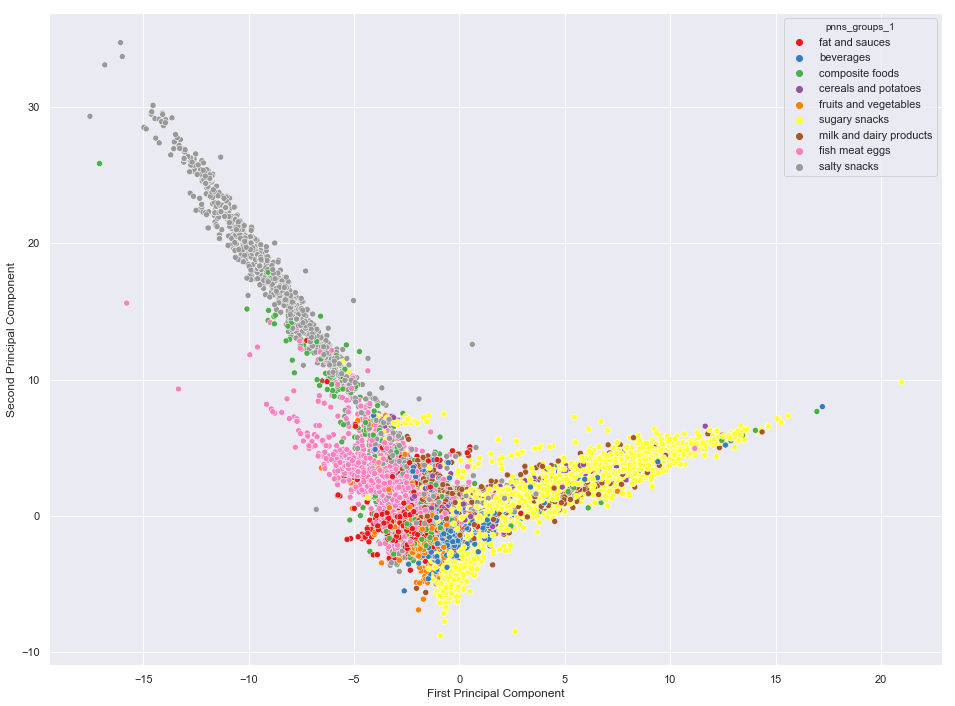

In [33]:
#---- PCA ----
pca = PCA(n_components=10)
pca.fit(scaled_data)
M_pca = pca.transform(scaled_data)
pca_features = M_pca
target = df_modified['pnns_groups_1']
plt.figure(figsize=(16,12))
sns.scatterplot(x=M_pca[:,0],y=M_pca[:,1],hue=df_modified['pnns_groups_1'],palette='Set1')
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')

*This is interesting to see that with 2 components, a lot of salty snacks products (grey color) seem to stand out from the crowd, while other categories like composite foods and beverages are much more concentrated in the middle and clustered together. Another remarkable point is that sugary snacks (yellow) and salty snacks (grey) are projected in opposite directions.*

### Datasets with PCA

In [50]:
pca = PCA(n_components=100)
pca.fit(scaled_data)
M_pca = pca.transform(scaled_data)
pca_features = M_pca
target = df_modified['pnns_groups_1']

In [51]:
X_pca_train, X_pca_test, y_pca_train, y_pca_test = train_test_split (
    pca_features,
    target,
    test_size=0.2, 
    random_state=101, 
    stratify=target)

X_pca_train_sample = X_pca_train[:20000,:]
y_pca_train_sample = y_pca_train[:20000]

In [38]:
X_pca_train_sample_2 = X_pca_train[:5000,:]
y_pca_train_sample_2 = y_pca_train[:5000]

### Random Forest, sample data

In [52]:
%%time
rf = RandomForestClassifier(
    n_estimators = 225,
    class_weight = 'balanced_subsample',
    criterion = 'gini',
    max_depth=80,
    max_features = 'log2',
    random_state = 21, 
    n_jobs = -1, 
)
rf.fit(X_pca_train_sample,y_pca_train_sample)
y_preds_train = rf.predict(X_pca_train_sample)
y_preds_test = rf.predict(X_pca_test)
classifier_metrics(y_test=y_pca_train_sample, y_preds=y_preds_train, average='macro', model='Full Train Set - Random forest')
classifier_metrics(y_test=y_pca_test, y_preds=y_preds_test, average='macro', model='Test Set - Random forest')

Full Train Set - Random forest Classification Metrics :
-------------------
Accuracy : 97.70%
Recall : 97.43%
Precision : 97.76%
F1-score : 97.54%


Test Set - Random forest Classification Metrics :
-------------------
Accuracy : 78.93%
Recall : 75.92%
Precision : 79.57%
F1-score : 77.27%


Wall time: 12.6 s


### One-vs-rest Elastic net Logistic regression with L2 penalty

In [59]:
%%time
from sklearn.linear_model import LogisticRegression
lg = LogisticRegression(
    penalty='elasticnet',
    l1_ratio=0,
    dual=False,
    tol=0.0001,
    C=0.85,
    fit_intercept=True,
    intercept_scaling=1,
    class_weight='balanced',
    random_state=None,
    solver='saga',
    max_iter=10000,
    multi_class='ovr',
    n_jobs=-1,
)
lg.fit(X_pca_train_sample,y_pca_train_sample)
y_preds_train = lg.predict(X_pca_train_sample)
y_preds_test = lg.predict(X_pca_test)
classifier_metrics(y_test=y_pca_train_sample, y_preds=y_preds_train, average='macro', model='Full PCA Train Set - Elastic Net Logistic Regression')
classifier_metrics(y_test=y_pca_test, y_preds=y_preds_test, average='macro', model='PCA Test Set - Elastic Net Logistic Regression')

Full PCA Train Set - Elastic Net Logistic Regression Classification Metrics :
-------------------
Accuracy : 73.06%
Recall : 70.48%
Precision : 70.42%
F1-score : 70.27%


PCA Test Set - Elastic Net Logistic Regression Classification Metrics :
-------------------
Accuracy : 72.17%
Recall : 69.67%
Precision : 69.31%
F1-score : 69.30%


Wall time: 23.9 s


### One-vs-rest Elastic net Logistic regression with L1 penalty

In [60]:
%%time
lg = LogisticRegression(
    penalty='elasticnet',
    l1_ratio=1,
    dual=False,
    tol=0.0001,
    C=0.85,
    fit_intercept=True,
    intercept_scaling=1,
    class_weight='balanced',
    random_state=None,
    solver='saga',
    max_iter=10000,
    multi_class='ovr',
    verbose=0,
    warm_start=False,
    n_jobs=-1,
)
lg.fit(X_pca_train_sample,y_pca_train_sample)
y_preds_train = lg.predict(X_pca_train_sample)
y_preds_test = lg.predict(X_pca_test)
classifier_metrics(y_test=y_pca_train_sample, y_preds=y_preds_train, average='macro', model='Full PCA Train Set - Elastic Net Logistic Regression')
classifier_metrics(y_test=y_pca_test, y_preds=y_preds_test, average='macro', model='PCA Test Set - Elastic Net Logistic Regression')

Full PCA Train Set - Elastic Net Logistic Regression Classification Metrics :
-------------------
Accuracy : 73.08%
Recall : 70.49%
Precision : 70.45%
F1-score : 70.29%


PCA Test Set - Elastic Net Logistic Regression Classification Metrics :
-------------------
Accuracy : 72.17%
Recall : 69.67%
Precision : 69.30%
F1-score : 69.29%


Wall time: 15.3 s


### One-vs-rest Elastic net Logistic regression with Mixed L1/L2 penalty

In [61]:
%%time
lg = LogisticRegression(
    penalty='elasticnet',
    l1_ratio=0.5,
    dual=False,
    tol=0.0001,
    C=0.85,
    fit_intercept=True,
    intercept_scaling=1,
    class_weight='balanced',
    random_state=None,
    solver='saga',
    max_iter=10000,
    multi_class='ovr',
    verbose=0,
    warm_start=False,
    n_jobs=-1,
)
lg.fit(X_pca_train_sample,y_pca_train_sample)
y_preds_train = lg.predict(X_pca_train_sample)
y_preds_test = lg.predict(X_pca_test)
classifier_metrics(y_test=y_pca_train_sample, y_preds=y_preds_train, average='macro', model='Full PCA Train Set - Elastic Net Logistic Regression')
classifier_metrics(y_test=y_pca_test, y_preds=y_preds_test, average='macro', model='PCA Test Set - Elastic Net Logistic Regression')

Full PCA Train Set - Elastic Net Logistic Regression Classification Metrics :
-------------------
Accuracy : 73.08%
Recall : 70.50%
Precision : 70.45%
F1-score : 70.29%


PCA Test Set - Elastic Net Logistic Regression Classification Metrics :
-------------------
Accuracy : 72.16%
Recall : 69.66%
Precision : 69.30%
F1-score : 69.29%


Wall time: 21.8 s


### Support Vectors Machine with RBF Kernel

In [46]:
%%time
from sklearn.svm import SVC
svc = SVC (
    kernel='rbf',
    C=0.5,
    gamma='auto'
    )
%time svc.fit(X_pca_train_sample,y_pca_train_sample)
y_preds_train = svc.predict(X_pca_train_sample)
#y_preds_test = svc.predict(X_pca_test)
classifier_metrics(y_test=y_pca_train_sample, y_preds=y_preds_train, average='macro', model='Full Train Set - SVC')
#classifier_metrics(y_test=y_pca_test, y_preds=y_preds_test, average='macro', model='Test Set - SVC')

Wall time: 19.3 s
Full Train Set - SVC Classification Metrics :
-------------------
Accuracy : 68.56%
Recall : 63.53%
Precision : 69.77%
F1-score : 64.87%


Wall time: 57.7 s


In [47]:
get_classification_report(y_test=y_pca_train_sample, y_pred=y_preds_train, model='SVC_Train', sortby='support')

,SVC_Train_precision,SVC_Train_recall,SVC_Train_f1-score,SVC_Train_support
macro avg,0.70,0.64,0.65,20000.00
weighted avg,0.70,0.69,0.68,20000.00
sugary snacks,0.78,0.86,0.82,4296.00
milk and dairy products,0.79,0.78,0.79,2682.00
fish meat eggs,0.72,0.74,0.73,2439.00
beverages,0.68,0.76,0.72,2286.00
composite foods,0.56,0.54,0.55,2086.00
cereals and potatoes,0.44,0.64,0.52,2073.00
fruits and vegetables,0.72,0.44,0.54,1646.00
fat and sauces,0.73,0.59,0.65,1272.00


# Part 2 - Predict $G_2$ with $G_1$

$Card(G_1)$ = 9 labels

$Card(G_2)$ = 38 labels

We now try to predict both $G_1$ and $G_2$.

Each member of $G_1$ contain a unique and different set of members of $G_2$ *(for example, all fruit nectars, milk based beverages are members of $G_1$ 'beverages' and only of this group)*
In other words, $G_1$ is correlated to $G_2$ (furthermore, $G_1$ has a strong predictive power score for $G_2$ as with $G_1$ known, we reduce the possible labels from 38 to a few set of possible labels. Note that $G_2$ also has a predictive power score of 1 to predict $G_1$ as there is a unique answer for $G_1$ if we know $G_2$)


For this part, we select only Ensemble methods the linear models and support vectors machines seem to not fit our dataset well, even if we reduce the dimensionality and scale the data. SVM are also long to train We explore more in depth tree-based methods as they seem to be adapted to the nature of the problem and are relatively fast.

We try Bagging and Boosting algorithms with the following structure:

1. Fit a model to predict $G_1$ (9 possible labels)
2. Add the $G_1$ prediction to the features ($X$)
3. Fit a model with updated X (938 features + $G_1$ predicted) to predict $G_2$ (38 possible labels)
4. Evaluate scores on both sets ($G_1$ & $G_2$)

## Dataset

In [7]:
#Data
df_modified = pd.read_csv(r'C:\Users\Antoine\Coding Bootcamp\Open Food Facts\data_training_names.csv', low_memory=False)
df_copy = df_modified.copy(deep=True)

In [20]:
#Feautres/Labels and train test split
features = df_modified.drop(columns=['pnns_groups_1', 'pnns_groups_2', 'pnns_groups_3', 'pnns_groups_4', 'code', 'url', 'ingredients', 'product_name'])
target = df_modified[['pnns_groups_1', 'pnns_groups_2']]
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42, stratify=target)
X_train_sample = X_train.sample(20000, random_state=1)
y_train_sample = y_train.sample(20000, random_state=1)
X_train.shape, y_train.shape

((134038, 938), (134038, 2))

In [22]:
y_train['pnns_groups_1'].value_counts()

sugary snacks              28976
milk and dairy products    17700
fish meat eggs             16231
beverages                  15452
cereals and potatoes       13902
composite foods            13847
fruits and vegetables      11290
fat and sauces              8338
salty snacks                8302
Name: pnns_groups_1, dtype: int64

In [23]:
y_train['pnns_groups_2'].value_counts()

biscuits and cakes                  12098
one dish meals                      11425
sweets                              11036
processed meat                       6754
cheese                               6627
cereals                              6384
milk and yogurt                      5788
dressings and sauces                 5474
vegetables                           5264
sweetened beverages                  5024
fish and seafood                     4418
chocolate products                   4359
meat                                 4054
salty and fatty products             3943
fruits                               3686
dairy desserts                       3324
bread                                3165
appetizers                           3160
unsweetened beverages                2931
fats                                 2864
fruit juices                         2390
breakfast cereals                    2210
artificially sweetened beverages     2030
ice cream                         

In [73]:
y_train_sample.value_counts() / y_train.value_counts()

pnns_groups_1            pnns_groups_2                   
beverages                artificially sweetened beverages    0.151724
                         fruit juices                        0.149791
                         fruit nectars                       0.137097
                         plant based milk substitutes        0.158103
                         sweetened beverages                 0.146696
                         teas and herbal teas and coffees    0.135135
                         unsweetened beverages               0.151143
                         waters and flavored waters          0.150912
cereals and potatoes     bread                               0.146919
                         breakfast cereals                   0.148416
                         cereals                             0.151786
                         legumes                             0.149502
                         potatoes                            0.153355
composite foods          one dis

### Label encoding

In [26]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(target['pnns_groups_1'])
encoded_target_1 = le.transform(target['pnns_groups_1']).reshape(-1,1)
le_2 = LabelEncoder()
le_2.fit(target['pnns_groups_2'])
encoded_target_2 = le_2.transform(target['pnns_groups_2']).reshape(-1,1)
encoded_target = np.append(encoded_target_1, encoded_target_2, axis=1)

In [27]:
X_train, X_test, y_train, y_test = train_test_split(features, encoded_target, test_size=0.2, random_state=42, stratify=encoded_target)
X_train_sample = X_train[:20000]
y_train_sample = y_train[:20000,:]
X_train.shape, y_train.shape

((134038, 938), (134038, 2))

## Models

### Random Forest in chain on sample data

In [ ]:
%%time
rf = RandomForestClassifier(
    n_estimators = 250,
    class_weight = 'balanced_subsample',
    criterion = 'gini',
    max_features = 'log2',
    random_state = 42, 
    max_samples = 0.7,
    n_jobs = -1, 
    verbose = 0, 
)
chain = ClassifierChain(base_estimator=rf,
    order=None,
    random_state=42)
chain.fit(X_train_sample, y_train_sample)
y_preds_train = chain.predict(X_train_sample)
y_preds_test = chain.predict(X_test)

In [100]:
classifier_metrics(y_test=y_train_sample[:,0], y_preds=y_preds_train[:,0], average='macro', model='Train Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_train_sample[:,1], y_preds=y_preds_train[:,1], average='macro', model='Train Set Class2 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - Random forests chain on sample')

Train Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 97.62%
Recall : 97.55%
Precision : 97.41%
F1-score : 97.39%


Test Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 82.24%
Recall : 80.36%
Precision : 81.61%
F1-score : 80.81%


Train Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 96.62%
Recall : 95.82%
Precision : 95.51%
F1-score : 95.20%


Test Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 74.26%
Recall : 67.93%
Precision : 72.89%
F1-score : 68.96%




In [36]:
%%time
rf = RandomForestClassifier(
    n_estimators = 1500,
    class_weight = 'balanced_subsample',
    criterion = 'gini',
    min_samples_split = 2,
    max_depth=90,
    max_features = 'log2',
    random_state = 42, 
    max_samples = 0.5,
    n_jobs = -1, 
)
chain = ClassifierChain(base_estimator=rf,
    order=None,
    random_state=42)
chain.fit(X_train, y_train)
y_preds_train = chain.predict(X_train)
y_preds_test = chain.predict(X_test)
classifier_metrics(y_test=y_train[:,0], y_preds=y_preds_train[:,0], average='macro', model='Train Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_train[:,1], y_preds=y_preds_train[:,1], average='macro', model='Train Set Class2 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - Random forests chain on sample')

Train Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 92.07%
Recall : 91.85%
Precision : 92.43%
F1-score : 91.76%


Test Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 84.83%
Recall : 83.84%
Precision : 84.93%
F1-score : 84.01%


Train Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 89.98%
Recall : 88.86%
Precision : 89.59%
F1-score : 88.49%


Test Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 78.89%
Recall : 75.10%
Precision : 78.24%
F1-score : 75.67%


Wall time: 32min 43s


In [18]:
report_1 = get_classification_report(y_test=le.inverse_transform(y_test[:,0]), y_pred=le.inverse_transform(y_preds_test[:,0].astype(int)), model='Test_1_rf_sample', sortby='precision')
report_2 = get_classification_report(y_test=le_2.inverse_transform(y_test[:,1]), y_pred=le_2.inverse_transform(y_preds_test[:,1].astype(int)), model='Test_2_rf_sample', sortby='precision')

Text(0.5,1,'Precision by category')

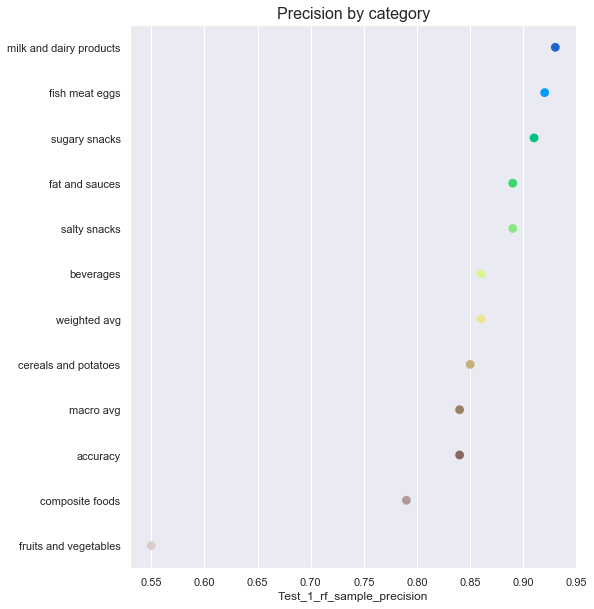

In [19]:
plt.figure(figsize=(8,10))
sns.pointplot(y=report_1.index, x=report_1['Test_1_rf_sample_precision'], palette='terrain', size=report_1['Test_1_rf_sample_support'])
plt.title('Precision by category', fontsize=16)

Text(0.5,1,'Precision by category')

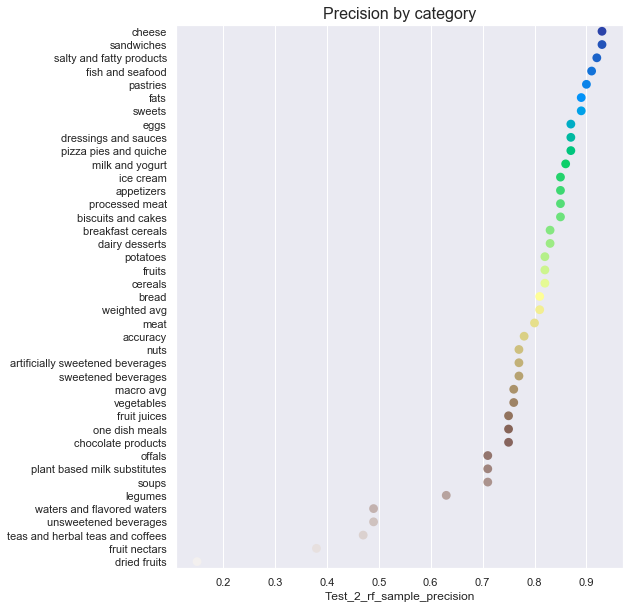

In [20]:
plt.figure(figsize=(8,10))
sns.pointplot(y=report_2.index, x=report_2['Test_2_rf_sample_precision'], palette='terrain', size=report_2['Test_2_rf_sample_support'])
plt.title('Precision by category', fontsize=16)

In [38]:
%%time

rf = RandomForestClassifier(
    n_estimators = 1800,
    class_weight = 'balanced_subsample',
    criterion = 'gini',
    min_samples_split = 2,
    max_depth=95,
    max_features = 'log2',
    ccp_alpha = 0.0, 
    random_state = 42, 
    max_samples = 0.75,
    n_jobs = -1,
    )

chain = ClassifierChain(
    base_estimator=rf,
    order=None,
    random_state=42
    )

chain.fit(X_train, y_train)

y_preds_train = chain.predict(X_train)
y_preds_test = chain.predict(X_test)

classifier_metrics(y_test=y_train[:,0], y_preds=y_preds_train[:,0], average='macro', model='Train Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_train[:,1], y_preds=y_preds_train[:,1], average='macro', model='Train Set Class2 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - Random forests chain on sample')

Train Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 93.81%
Recall : 93.63%
Precision : 93.95%
F1-score : 93.49%


Test Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 85.62%
Recall : 84.59%
Precision : 85.55%
F1-score : 84.77%


Train Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 92.16%
Recall : 91.05%
Precision : 91.48%
F1-score : 90.62%


Test Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 79.67%
Recall : 75.94%
Precision : 78.90%
F1-score : 76.49%


Wall time: 46min 45s


## Adaboost

In [ ]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier

### Sample data, limited tree max depth, high learning rate, 50 estimators

We first test adaboost on sample data with a high learning rate, to see how it react and time computation.

In [12]:
%%time

dt = DecisionTreeClassifier(
    criterion='gini', 
    splitter='best', 
    max_depth=15, 
    max_features='log2', 
    random_state=42, 
    class_weight='balanced', 
    )

ada = AdaBoostClassifier(
    base_estimator=dt, 
    n_estimators=50, 
    learning_rate=1.5, 
    algorithm='SAMME.R', 
    random_state=42
    )
chain = ClassifierChain(
    base_estimator=ada,
    order=None,
    random_state=42
    )

chain.fit(X_train_sample, y_train_sample)

y_preds_train = chain.predict(X_train_sample)
y_preds_test = chain.predict(X_test)

classifier_metrics(y_test=y_train_sample[:,0], y_preds=y_preds_train[:,0], average='macro', model='Train Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_train_sample[:,1], y_preds=y_preds_train[:,1], average='macro', model='Train Set Class2 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - Random forests chain on sample')

Train Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 72.25%
Recall : 70.71%
Precision : 71.33%
F1-score : 70.69%


Test Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 65.57%
Recall : 63.49%
Precision : 64.28%
F1-score : 63.49%


Train Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 57.17%
Recall : 51.31%
Precision : 57.67%
F1-score : 52.33%


Test Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 50.15%
Recall : 44.07%
Precision : 50.00%
F1-score : 45.11%


Wall time: 42.7 s


### Full data, limited tree depth (15), 50 estimators high learning rate

In [11]:
%%time

dt = DecisionTreeClassifier(
    criterion='gini', 
    splitter='best', 
    max_depth=15, 
    max_features='log2', 
    random_state=42, 
    class_weight='balanced',
    )

ada = AdaBoostClassifier(
    base_estimator=dt, 
    n_estimators=50, 
    learning_rate=1.0, 
    algorithm='SAMME.R', 
    random_state=42
    )
    
chain = ClassifierChain(
    base_estimator=ada,
    order=None,
    random_state=42
    )

chain.fit(X_train, y_train)

y_preds_train = chain.predict(X_train)
y_preds_test = chain.predict(X_test)

classifier_metrics(y_test=y_train[:,0], y_preds=y_preds_train[:,0], average='macro', model='Train Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_train[:,1], y_preds=y_preds_train[:,1], average='macro', model='Train Set Class2 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - Random forests chain on sample')

Train Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 80.07%
Recall : 78.28%
Precision : 78.69%
F1-score : 78.34%


Test Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 76.43%
Recall : 74.37%
Precision : 74.78%
F1-score : 74.45%


Train Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 62.29%
Recall : 52.51%
Precision : 62.37%
F1-score : 54.64%


Test Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 59.19%
Recall : 50.00%
Precision : 59.62%
F1-score : 52.05%


Wall time: 3min 16s


### Sample data, small learning rate and no limitations

Now we try to train more estimators (150) on sample data with a significantly smaller learning rate (from 1.5 to 0.08). We first not set a max_depth to see scores on training set and the level of overfitting. However, we set max_features to log_2 as this is a parameter that worked well and we keep balanced class weights.

In [20]:
%%time

dt = DecisionTreeClassifier(
    criterion='gini', 
    splitter='best', 
    max_depth=None, 
    max_features='log2', 
    random_state=42, 
    class_weight='balanced', 
    )

ada = AdaBoostClassifier(
    base_estimator=dt, 
    n_estimators=150, 
    learning_rate=0.08, 
    algorithm='SAMME.R', 
    random_state=42
    )

chain = ClassifierChain(
    base_estimator=ada,
    order=None,
    random_state=42
    )

chain.fit(X_train_sample, y_train_sample)
y_preds_train = chain.predict(X_train_sample)
y_preds_test = chain.predict(X_test)

classifier_metrics(y_test=y_train_sample[:,0], y_preds=y_preds_train[:,0], average='macro', model='Train Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_train_sample[:,1], y_preds=y_preds_train[:,1], average='macro', model='Train Set Class2 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - Random forests chain on sample')

Train Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 97.65%
Recall : 97.60%
Precision : 97.41%
F1-score : 97.41%


Test Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 80.73%
Recall : 78.93%
Precision : 79.69%
F1-score : 79.14%


Train Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 96.60%
Recall : 95.71%
Precision : 95.49%
F1-score : 95.11%


Test Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 73.79%
Recall : 67.12%
Precision : 73.65%
F1-score : 68.71%


Wall time: 2min 37s


Finally, we try to prevent tree depth not with max depth but with min_samples_leaf set to 4. This means that for every leaf in a tree, the number of produts have to be at least 4. We retry sqrt for max_features because we want diversity in tree construction but cover more features than log2 in Adaboost, to have trees that cover a higher part of the dataset to minimize error (unlike bagging methods tested with log2) but still prevent overfitting and get diversity , (log2 may work as well, we did not try with this params set) and balanced sub_sample. 
We set a higher number of estimators (300) and a small learning rate (0.05).

In [15]:
%%time

dt = DecisionTreeClassifier(
    criterion='gini', 
    splitter='best', 
    max_depth=None, 
    min_samples_leaf=4, 
    max_features='sqrt', 
    random_state=42, 
    class_weight='balanced', 
    ccp_alpha=0.0
    )

ada = AdaBoostClassifier(
    base_estimator=dt, 
    n_estimators=300, 
    learning_rate=0.05, 
    algorithm='SAMME.R', 
    random_state=42
    )

chain = ClassifierChain(
    base_estimator=ada,
    order=None,
    random_state=42
    )

chain.fit(X_train, y_train)

y_preds_train = chain.predict(X_train)
y_preds_test = chain.predict(X_test)

classifier_metrics(y_test=y_train[:,0], y_preds=y_preds_train[:,0], average='macro', model='Train Set Class1 - AdaBoost chain on full')
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - AdaBoost chain on full')
classifier_metrics(y_test=y_train[:,1], y_preds=y_preds_train[:,1], average='macro', model='Train Set Class2 - AdaBoost chain on full')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - AdaBoost chain on full')

Train Set Class1 - AdaBoost chain on full Classification Metrics :
-------------------
Accuracy : 94.16%
Recall : 93.71%
Precision : 94.00%
F1-score : 93.67%


Test Set Class1 - AdaBoost chain on full Classification Metrics :
-------------------
Accuracy : 83.34%
Recall : 81.63%
Precision : 83.11%
F1-score : 82.11%


Train Set Class2 - AdaBoost chain on full Classification Metrics :
-------------------
Accuracy : 91.77%
Recall : 88.63%
Precision : 91.04%
F1-score : 89.50%


Test Set Class2 - AdaBoost chain on full Classification Metrics :
-------------------
Accuracy : 76.67%
Recall : 69.39%
Precision : 77.61%
F1-score : 72.61%


Wall time: 50min 35s


### Scores per category

In [32]:
#Report for G1
report_1 = get_classification_report(y_test=le.inverse_transform(y_test[:,0]), y_pred=le.inverse_transform(y_preds_test[:,0].astype(int)), model='Test_1_Adaboost', sortby='support')
#Report for G2
report_2 = get_classification_report(y_test=le_2.inverse_transform(y_test[:,1]), y_pred=le_2.inverse_transform(y_preds_test[:,1].astype(int)), model='Test_2_Adaboost', sortby='support')

In [31]:
report_1

,Test_1_Adaboost_precision,Test_1_Adaboost_recall,Test_1_Adaboost_f1-score,Test_1_Adaboost_support
milk and dairy products,0.91,0.86,0.88,4425.00
sugary snacks,0.90,0.87,0.89,7244.00
fish meat eggs,0.90,0.81,0.85,4057.00
beverages,0.84,0.85,0.84,3864.00
weighted avg,0.83,0.82,0.82,33510.00
fat and sauces,0.82,0.84,0.83,2085.00
accuracy,0.82,0.82,0.82,0.82
cereals and potatoes,0.81,0.75,0.78,3476.00
macro avg,0.81,0.81,0.81,33510.00
salty snacks,0.80,0.78,0.79,2075.00


In [34]:
report_2

,Test_2_Adaboost_precision,Test_2_Adaboost_recall,Test_2_Adaboost_f1-score,Test_2_Adaboost_support
weighted avg,0.77,0.73,0.73,33510.00
macro avg,0.66,0.75,0.68,33510.00
biscuits and cakes,0.86,0.75,0.80,3025.00
one dish meals,0.77,0.54,0.64,2856.00
sweets,0.88,0.69,0.77,2759.00
processed meat,0.81,0.90,0.85,1688.00
cheese,0.92,0.86,0.89,1657.00
cereals,0.79,0.69,0.74,1596.00
milk and yogurt,0.86,0.82,0.84,1447.00
dressings and sauces,0.80,0.84,0.82,1369.00


Text(0.5,1,'Adaboost Class 1 Precision by category')

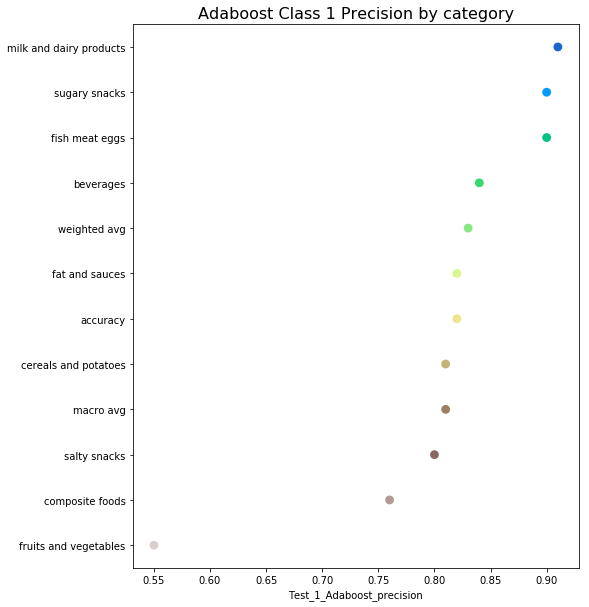

In [29]:
plt.figure(figsize=(8,10))
sns.pointplot(y=report_1.index, x=report_1['Test_1_Adaboost_precision'], palette='terrain', size=report_1['Test_1_Adaboost_support'])
plt.title('Adaboost Class 1 Precision by category', fontsize=16)

Text(0.5,1,'Adaboost Class 2 Precision by category')

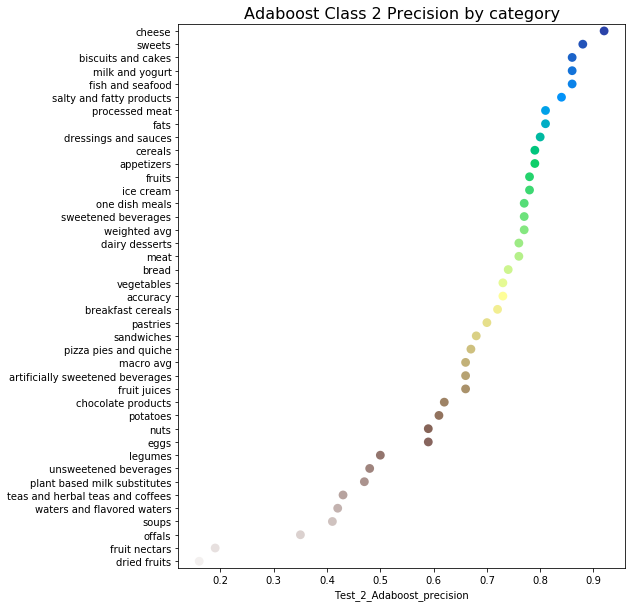

In [30]:
plt.figure(figsize=(8,10))
sns.pointplot(y=report_2.index, x=report_2['Test_2_Adaboost_precision'], palette='terrain', size=report_2['Test_2_Adaboost_support'])
plt.title('Adaboost Class 2 Precision by category', fontsize=16)

### Save Adaboost best model

In [51]:
#Pickle
import pickle

#Save model
pkl_filename = "adaboost.pkl"
with open(pkl_filename, 'wb') as file:
    pickle.dump(chain, file)

#Load model
with open(pkl_filename, 'rb') as file:
    pickle_model = pickle.load(file)
    
# Check if scores for test_dataset are similar
y_preds_test = pickle_model.predict(X_test)
classifier_metrics(y_test=y_test[:,0], y_preds=y_preds_test[:,0], average='macro', model='Test Set Class1 - Random forests chain on sample')
classifier_metrics(y_test=y_test[:,1], y_preds=y_preds_test[:,1], average='macro', model='Test Set Class2 - Random forests chain on sample')

Test Set Class1 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 83.34%
Recall : 81.63%
Precision : 83.11%
F1-score : 82.11%


Test Set Class2 - Random forests chain on sample Classification Metrics :
-------------------
Accuracy : 76.67%
Recall : 69.39%
Precision : 77.61%
F1-score : 72.61%




### Note

We stop here for this notebook the exploration of models and parameters tuning. Because of the size of Random Forest, we only keep Adaboost and will compare it with XGBoost in further work. We will also try tuning Adaboost and XGBoost parameters in another notebook.

For the moment, Tree-based methods seems to be a good option for our task. We got pretty encouraging results for $G_1$. For $G_2$, the actual conclusion is more nuanced as we did not get 85%+ precision for more than 15 categories over 38.